<a href="https://colab.research.google.com/github/SayanaVrgs/AI_for_Enhancing_Electronic_Monitoring_of_Fishing_Vessels/blob/main/AI_EM_RetinaNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Applying Convolutional Neural Networks to Fisheries Electronic Monitoring Data**

Jason Ceci, Jian Lin, Mohsen Kasiri, Sayana Varughese



#1 Analyze the Dataset

Here we analyze the dataset to get a feel of the data and see how the data is formated, if the classes are distributed well and if any problems with the data are identified.

Dataset Info obtained from python script below.
__________________________________________________________

img_id     : name of image <br>
bbox_id    : bounding boxes<br>
x_min      : this is image pixcel location<br>
x_max      : this is image pixcel location<br>
y_min      : this is image pixcel location<br>
y_max      : this is image pixcel location<br>
label_l1   : label <br>
label_l2   : lable<br>
fao_mfa    : major fishing area<br>
____________________________________________________________

Summary of datasets :<br>
There are total of 86,029 unique images.<br>
Each image could have different box_id to identify specific region <br>
There are total of 406,463 labels <br>



In [ ]:
import math
import numpy   as np
import pandas  as pd
import os
import sys
import matplotlib.pyplot                as plt
from   skimage.io                       import imread, imshow
#pip install fiftyone
import fiftyone as fo

In [ ]:
# read the dataset in the dataframe datatype using pandas
labels_df = pd.read_csv('labels\\foid_labels_bbox_v020.csv')
column_name = labels_df.columns #  total number of columuns which is also total number of variables is 9, list datatype
labels_df.shape                 # number of images is 86029 image and each image has 9 variable
labels_df[column_name[8]]
# labels_df.head(5)
# labels_df.tail(5)
# labels_df.info(verbose = True, memory_usage = "deep" )  # verbose means wordy, provide more information
# labels_df.info(verbose = False, memory_usage = "deep" ) #


#labels_df_memory = sys.getsizeof(labels_df)/1000000  # unit is MB
os.chdir('\\images')

label_l1               = labels_df[['label_l1']]  # It has 34 unique labels
label_l2               = labels_df[['label_l2']]  # It has 15 unique labels
image_id               = labels_df[['img_id']]
fao_mfa                = labels_df[['fao_mfa']]
label_l1.describe()      # it has total of 15 unique labels
label_l2.describe()      # it has total of 15 unique labels
label_l1_unique_labels = label_l1.drop_duplicates()
label_l2_unique_labels = label_l2.drop_duplicates()
image_id_unique        = image_id.drop_duplicates()
label                  = labels_df[['label_l1']]
label                  = label.values.tolist()    #convert to datatype list
#len(image_id_unique)
#len(image_id)


In [ ]:
illegal_fish_list = []
k =0;
for i in range(0,len(label_l1_unique_labels)):
    name = label_l1_unique_labels.iloc[i,:].values[0]
    #print(name)
    for j in range(0,len(label_l1)):
        if(label_l1.iloc[j,:].values[0] == name):
            k= k+1;
    #print("Total count of",name,"in label_l1 is",k)
    if k <= 1000:       # illegal
        illegal_fish_list.append(name)
        print(illegal_fish_list)
    k=0

illegal_fish_list.append('Unknown')    # add unknown label as ilegal fish as we'd rather have false negative

**Below Determines the number of objects in each Class or type of fish in the entire dataset so we can get a sense of the data. **

In [ ]:
fish_label = []

for i in label:
    if i in illegal_fish_list:
        i = 'illegal'
    else:
        i='legal'

    fish_label.append(i)

legal_fish_label

In [ ]:
Image_ID_and_Fish_Lable_df = pd.concat([image_id,fish_label], axis =1 )  # combine image ID and fish label into one dataframe
Image_ID_and_Fish_Lable_df = Image_ID_and_Fish_Lable_df.drop_duplicates(subset=['img_id'], keep='first')
                                    # delete duplicate rows
                                    # subset is the column you want to reduce
                                    # keep only accepts 'first' => keep first row if duplicate
len(Image_ID_and_Fish_Lable_df)     # This is also the total number of images that we have

86029

In [ ]:
# k =0;
# for i in range(0,len(label_l1_unique_labels)):
#     name = label_l1_unique_labels.iloc[i,:].values[0]
#     #print(name)
#     for j in range(0,len(label_l1)):
#         if(label_l1.iloc[j,:].values[0] == name):
#             k= k+1;
#     print("Total count of",name,"in label_l1 is",k)
#     k=0

# Total count of Human is 281040
# Total count of No fish is 1965
# Total count of Yellowfin tuna is 28785
# Total count of Albacore is 49724
# Total count of Wahoo is 648
# Total count of Indo Pacific sailfish is 129
# Total count of Oilfish is 778
# Total count of Mahi mahi is 3686
# Total count of Bigeye tuna is 6071
# Total count of Skipjack tuna is 19528
# Total count of Opah is 1681
# Total count of Striped marlin is 776
# Total count of Swordfish is 1232
# Total count of Shark is 784
# Total count of Sickle pomfret is 83
# Total count of Great barracuda is 163
# Total count of Black marlin is 80
# Total count of Unknown is 6779
# Total count of Shortbill spearfish is 406
# Total count of Roudie scolar is 4
# Total count of Long snouted lancetfish is 176
# Total count of Thresher shark is 1
# Total count of Pelagic stingray is 51
# Total count of Snake mackerel is 2
# Total count of Blue marlin is 442
# Total count of Rainbow runner is 2
# Total count of Pomfret is 2
# Total count of Mola mola is 6
# Total count of Tuna is 835
# Total count of Marlin is 54
# Total count of Water is 74
# Total count of Escolar is 430
# Total count of Lancetfish is 45
# Total count of Brama is 1

**Here, we assign labels to certain families of similar fish in an attempt to reduce groups with very low number like above. This reduces the number of low count classes considerably**

In [ ]:
# k =0;
# for i in range(0,len(label_l2_unique_labels)):
#     name = label_l2_unique_labels.iloc[i,:].values[0]
#     #print(name)
#     for j in range(0,len(label_l2)):
#         if(label_l2.iloc[j,:].values[0] == name):
#             k= k+1;
#     print("Total count of",name,"in label_l2 is",k)
#     k=0
# Total count of HUMAN in label_l2 is 281040
# Total count of NoF in label_l2 is 1965
# Total count of YFT in label_l2 is 28785
# Total count of ALB in label_l2 is 49724
# Total count of OTH in label_l2 is 9115
# Total count of BILL in label_l2 is 3119
# Total count of DOL in label_l2 is 3686
# Total count of BET in label_l2 is 6071
# Total count of SKJ in label_l2 is 19528
# Total count of LAG in label_l2 is 1681
# Total count of SHARK in label_l2 is 785
# Total count of OIL in label_l2 is 4
# Total count of PLS in label_l2 is 51
# Total count of TUNA in label_l2 is 835
# Total count of WATER in label_l2 is 74

#2 Data Preprocessing

Below is the code to preprocess the csv files and images for the 4 models. The The code groups the labels and images according to the model, and formats them as requried by the model.

**Model 1**

In [ ]:

import csv

image_data = {}

f = open('fishNofish.csv','w', newline='')
    # create the csv writer
writer = csv.writer(f)

writer.writerow(["img_id","x_min","y_min","x_max","y_max","label_l1"])


with open('foid_labels_bbox_v020.csv', mode='r') as f1:
    reader = csv.reader(f1, delimiter=',')
    for n, row in enumerate(reader):
        if not n:
            # Skip header row (n = 0).
            continue
        img_id, bbox_id, x_min, x_max, y_min, y_max, label_l1,label_l2,fao_mfa = row
        #classification of fish or no fish
        if label_l1 in ("Albacore","Bigeye tuna","Black marlin","Blue marlin","Brama","Escolar","Great barracuda","Indo Pacific sailfish","Lancetfish","Mahi mahi","Long snouted lancetfish","Marlin","Mola mola","Oilfish","Opah","Pelagic stingray","Pomfret","Rainbow runner","Shark","Roudie scolar","Shortbill spearfish","Sickle pomfret","Skipjack tuna","Snake mackerel","Striped marlin","Swordfish","Thresher shark","Tuna","Wahoo","Yellowfin tuna"):
            label_l1="Fish"
        elif label_l1 == "Unknown":
            label_l1="Unknown"
        else:
            label_l1="No Fish"
        #checking of x_min y_min is negative and changing them to 0
        if int(x_min)<0:
            x_min = 0
        if int(y_min)<0:
            y_min = 0
        row_contents = [img_id,x_min,y_min,x_max,y_max,label_l1]
        #if img_id not in image_data:
            #image_data[img_id] = list()
        #image_data[img_id].append(label_l1)
        #str1=img_id+","+x_min+","+y_min+","+x_max+","+y_max+","+label_l1
        writer.writerow(row_contents)



f.close()



**Model 2**

In [ ]:


import csv

image_data = {}

f = open('genericFish.csv','w', newline='')
    # create the csv writer
writer = csv.writer(f)

writer.writerow(["img_id","x_min","y_min","x_max","y_max","label_l1"])


with open('foid_labels_bbox_v020.csv', mode='r') as f1:
    reader = csv.reader(f1, delimiter=',')
    for n, row in enumerate(reader):
        if not n:
            # Skip header row (n = 0).
            continue
        img_id, bbox_id, x_min, x_max, y_min, y_max, label_l1,label_l2,fao_mfa = row
        if label_l1 in ("Albacore","Bigeye tuna","Yellowfin tuna","Tuna","Skipjack tuna"):
            label_l1="Tuna"
        elif label_l1 in ("Black marlin","Blue marlin","Marlin","Striped marlin","Shortbill spearfish"):
            label_l1="Marlin"
        elif label_l1 in ("Brama","Pomfret","Sickle pomfret"):
            label_l1="Pomfret"
        elif label_l1 in ("Escolar","Oilfish","Snake mackerel","Roudie scolar","Wahoo"):
            label_l1="Mackerel"
        elif label_l1 in ("Lancetfish","Long snouted lancetfish"):
            label_l1="Lancetfish"
        elif label_l1 in ("Thresher shark","Shark"):
            label_l1="Shark"
        elif label_l1 in ("Great barracuda","Indo Pacific sailfish","Mahi mahi","Mola mola","Opah","Pelagic stingray", "Rainbow runner","Swordfish"):
            label_l1="Fish"
        elif label_l1 == "Unknown":
            label_l1="Unknown"
        else:
            label_l1="No Fish"
        row_contents = [img_id,x_min,y_min,x_max,y_max,label_l1]

        #checking of x_min y_min is negative and changing them to 0
        if int(x_min)<0:
            x_min = 0
        if int(y_min)<0:
            y_min = 0

        writer.writerow(row_contents)



f.close()


**Model 3**

In [ ]:
#All the Labels
import csv

image_data = {}

f = open('AllLabel.csv','w', newline='')
    # create the csv writer
writer = csv.writer(f)

writer.writerow(["img_id","x_min","y_min","x_max","y_max","label_l1"])


with open('foid_labels_bbox_v020.csv', mode='r') as f1:
    reader = csv.reader(f1, delimiter=',')
    for n, row in enumerate(reader):
        if not n:
            # Skip header row (n = 0).
            continue
        img_id, bbox_id, x_min, x_max, y_min, y_max, label_l1,label_l2,fao_mfa = row

        #checking of x_min y_min is negative and changing them to 0
        if int(x_min)<0:
            x_min = 0
        if int(y_min)<0:
            y_min = 0

        row_contents = [img_id,x_min,y_min,x_max,y_max,label_l1]



        writer.writerow(row_contents)



f.close()



**Model 4**


In [ ]:


f = open('/content/drive/My Drive/fishWithNeg2.csv','w', newline='')
    # create the csv writer
writer = csv.writer(f)

writer.writerow(["img_id","x_min","y_min","x_max","y_max","label_l1"])


with open('/content/drive/My Drive/foid_labels_bbox_v020.csv', mode='r') as f1:
    reader = csv.reader(f1, delimiter=',')
    for n, row in enumerate(reader):
        if not n:
            # Skip header row (n = 0).
            continue
        img_id, bbox_id, x_min, x_max, y_min, y_max, label_l1,label_l2,fao_mfa = row
        #classification of fish
        if label_l1 in ("Albacore","Bigeye tuna","Black marlin","Blue marlin","Brama","Escolar","Great barracuda","Indo Pacific sailfish","Lancetfish","Mahi mahi","Long snouted lancetfish","Marlin","Mola mola","Oilfish","Opah","Pelagic stingray","Pomfret","Rainbow runner","Shark","Roudie scolar","Shortbill spearfish","Sickle pomfret","Skipjack tuna","Snake mackerel","Striped marlin","Swordfish","Thresher shark","Tuna","Wahoo","Yellowfin tuna"):
            if img_id not in imagesWithFish:
                imagesWithFish.add(img_id)
            label_l1="Fish"
            if int(x_min)<0:
                x_min = 0
            if int(y_min)<0:
                y_min = 0
            row_contents = [img_id,int(x_min),int(y_min),int(x_max),int(y_max),label_l1]
            writer.writerow(row_contents)

with open('/content/drive/My Drive/foid_labels_bbox_v020.csv', mode='r') as f2:
    reader = csv.reader(f2, delimiter=',')
    for n, row in enumerate(reader):
        if not n:
            # Skip header row (n = 0).
            continue
        img_id, bbox_id, x_min, x_max, y_min, y_max, label_l1,label_l2,fao_mfa = row
        #if images does not contain fish
        if img_id not in imagesWithFish:
            label_l1=""
            x_min=""
            y_min=""
            x_max=""
            y_max=""
            row_contents = [img_id,x_min,y_min,x_max,y_max,label_l1]
            writer.writerow(row_contents)
            imagesWithFish.add(img_id) # append to prevent duplicate blank imgids

f.close()

# 3 Setting Up and Training the Retina Net CCN

                                   # train 60%            => 243877
                                   # test  20%            => 81293
                                   # val   20%            => 81293  
                        
The split we used for training, testing and validation is shown above.

**Please note code below was run on a Compute Canada Cluster instance and may require changes to path, GPU settings, etc.**




Functions that used for fish object dectectioin

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters
from sklearn.model_selection import train_test_split
import urllib
import os
import csv
import cv2
import time
import skimage.io
from sklearn import datasets
from sklearn import preprocessing
from PIL import Image
import math
import sys
import random

Clone this repository into local machine

In [ ]:
git clone https://github.com/fizyr/keras-retinanet

Download datasets:

https://www.fishnet.ai/download # This is dataset used by DFO<br>

https://www.kaggle.com/c/the-nature-conservancy-fisheries-monitoring #This dataset provided by Kaggle<br>



Change directory to keras-retinanet

In [ ]:
os.chdir("\project\\Anslysis of big data\\keras-retinanet")

In [ ]:
def show_image_objects(image_row):
  img_path = image_row.img_id
  box      = [image_row.x_min, image_row.y_min, image_row.x_max, image_row.y_max]
  image    = read_image_bgr(img_path)
  draw     = image.copy()
  draw     = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
  draw_box(draw, box, color=(255, 0, 0)) # draw_box is a bulit-in fuction
  plt.axis('off')
  plt.imshow(draw)
  plt.show()

# def predict(image):
#   image                 = preprocess_image(image.copy())
#   image, scale          = resize_image(image)
#   boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
#   boxes /= scale
#   return boxes, scores, labels


# def draw_detections(image, boxes, scores, labels):
#   for box, score, label in zip(boxes[0], scores[0], labels[0]):
#     if score < THRES_SCORE:
#       break
#     color = label_color(label)
#     b = box.astype(int)
#     draw_box(image, b, color=color)
#     caption = "{} {:.3f}".format(labels_to_names[label], score)
#     draw_caption(image, b, caption)

THRES_SCORE = 0.50  # threshold cutoff

def show_detected_objects(image_row):
  img_path              = image_row.img_id
  true_box              = [image_row.x_min, image_row.y_min, image_row.x_max, image_row.y_max]
  image                 = read_image_bgr(img_path)
  draw                  = image.copy()
  draw                  = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB) #
  image                 = preprocess_image(image)
  image, scale          = resize_image(image)

  boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
  boxes                /= scale
  draw_box(draw, true_box, color=(255, 0, 0))

  for box, score, label in zip(boxes[0], scores[0], labels[0]):
    #if score < THRES_SCORE or label >2  or label <0: # for fishNofish model
    #if score < THRES_SCORE or label >8  or label <0: # for genricFish model
    if score < THRES_SCORE or label >33 or label <0: # for Alllabel model
      break
    print("The object is %s wtih score %f" %(labels_to_names[label],score))
    color = label_color(label)
    b = box.astype(int)
    draw_box(draw, b, color=color) # draw detected boxes
    caption = "{} {:.3f}".format(labels_to_names[label], score)
    draw_caption(draw, b, caption)

  plt.axis('off')
  plt.imshow(draw)
  plt.show()

plt.rcParams["figure.figsize"] = [14.00, 7]
plt.rcParams["figure.autolayout"] = True


In [ ]:
!pip install .

Processing c:\users\kevin\desktop\project\anslysis of big data\keras-retinanet
  Created wheel for keras-retinanet: filename=keras_retinanet-1.0.0-cp38-cp38-win_amd64.whl size=132308 sha256=3e7d0cdc46bcd281a831ddca42e0395a2f8b7a17ee3db0508f34697033b004e4
  Stored in directory: c:\users\kevin\appdata\local\pip\cache\wheels\e5\80\36\499a7f8a03aa1acaee3277d67949538aec09367f2981740071
Successfully built keras-retinanet
  Attempting uninstall: keras-retinanet
    Found existing installation: keras-retinanet 1.0.0
    Uninstalling keras-retinanet-1.0.0:
      Successfully uninstalled keras-retinanet-1.0.0


buildup model

In [ ]:
!python setup.py build_ext --inplace

running build_ext
skipping 'keras_retinanet/utils\compute_overlap.c' Cython extension (up-to-date)
copying build\lib.win-amd64-3.8\keras_retinanet\utils\compute_overlap.cp38-win_amd64.pyd -> keras_retinanet\utils


In [ ]:
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [ ]:
label_full = label_full.drop(columns=["img_id"])
img_id = pd.DataFrame(a,columns=["img_id"])
img_id.head()
label_full = pd.concat([label_full,img_id],axis=1)
label_full = label_full[["img_id","x_min","y_min","x_max","y_max","label_l1"]]

label_full.head(5)
label_full.to_csv('label_full_withtout_header.csv',index =False, header = False )
label_full_withtout_header = pd.read_csv('label_full_withtout_header.csv')
label_full_withtout_header.head(5)

In [ ]:
train and test split
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

train_df, test_df = train_test_split(label_full, test_size = .99,random_state = RANDOM_SEED)
len(train_df)

In [ ]:
PRETRAINED_MODEL = './snapshots/_pretrained_model.h5'
URL_MODEL = 'https://github.com/fizyr/keras-retinanet/releases/download/0.5.1/resnet50_coco_best_v2.1.0.h5'
# download the best trained model as _pretrained model
urllib.request.urlretrieve(URL_MODEL, PRETRAINED_MODEL)

In [ ]:
PRETRAINED_MODEL_fishent_1 = './snapshots/resnet50_csv_01.h5'

In [ ]:
ANNOTATIONS_FILE  = 'label_full_withtout_header.csv'
CLASSES_FILE      = 'class_fish_mapping_full.csv'
ANNOTATIONS_FILE      = 'annotation.csv'
CLASSES_FILE          = 'classes_without_header.csv'
ANNOTATIONS_FILE_test = 'annotation_test.csv'
csv annotation_withoutheader.csv classes_without_header.csv
csv label_full_withtout_header.csv class_fish_mapping_full.csv

Train the model. It accepts csv input file

In [ ]:
!python keras_retinanet/bin/train.py \
--random-transform \
--weights {PRETRAINED_MODEL} \
--batch-size 4 \
--steps 10 \
--epochs 2 \
csv annotation_withoutheader.csv classes_without_header.csv

Train model in GPU at Compute Canada Cluster

In [ ]:
#!/bin/bash
#SBATCH --account=def-oui222
#SBATCH --nodes=1
#SBATCH --tasks-per-node=1
#SBATCH --gres=gpu:4
#SBATCH --cpus-per-task=32       #
#SBATCH --time=1-00:00:00
#SBATCH --mem=120G
#SBATCH --output=slurm.%x.%j.out
#SBATCH --array=1-50%1
cd keras-retinanet
source ../fishnet/bin/activate

tensorboard --logdir=../logs --host 0.0.0.0 --load_fast false & #0000 means host, and percent sign means background

../fishnet/bin/retinanet-train  --random-transform --weights "./snapshots/resnet50_csv_07.h5" --batch-size 2  --epochs 7 --tensorboard-dir ../logs --tensorboard-freq epoch csv fishWithNeg_train.csv fishWithNeg_mapping.csv


#4 Testing the Model on New Images

Here we test the model on new images from the test data set to verify the predict function are working. We overlay the images with the predictions and the ground truth bounding boxes to verify the model works.

In [ ]:
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [ ]:
#model_path = os.path.join('snapshots',sorted(os.listdir('snapshots'), reverse=True)[0])  #pre-trained model can be pre saved and re loaded.
model_fishWithNeg       = ("./snapshots/fishWithNeg.h5")
model_path_AllLabel     = ("./snapshots/AllLabel.h5")
model_path_fishNofish   = ("./snapshots/fishNofish.h5")
model_path_genericFish  = ("./snapshots/genericFish.h5")

In [ ]:
#pre_trained_model= models.load_model(model_path_pretrained, backbone_name='resnet50')
model_fishWithNeg = models.load_model(model_fishWithNeg, backbone_name='resnet50')
model_AllLabel = models.load_model(model_path_AllLabel, backbone_name='resnet50')
model_fishNofish = models.load_model(model_path_fishNofish, backbone_name='resnet50')
model_genericFish = models.load_model(model_path_genericFish, backbone_name='resnet50')

In [ ]:
#model= models.convert_model(model)
#model_1= models.convert_model(pre_trained_model)
model_fishWithNeg  = models.convert_model(model_fishWithNeg)
model_fishNofish  = models.convert_model(model_fishNofish)
model_genericFish = models.convert_model(model_genericFish)
model_AllLabel    = models.convert_model(model_AllLabel)

In [ ]:
!chmod 755 -R keras_retinanet # provide access to google drive

In [ ]:
#model_path = os.path.join('snapshots',sorted(os.listdir('snapshots'), reverse=True)[0])  #pre-trained model can be pre saved and re loaded.
model_path_AllLabel  = ("./snapshots/AllLabel.h5")
model_path_fishNofish  = ("./snapshots/fishNofish.h5")
model_path_genericFish  = ("./snapshots/genericFish.h5")

In [ ]:
#pre_trained_model= models.load_model(model_path_pretrained, backbone_name='resnet50')
model_AllLabel = models.load_model(model_path_AllLabel, backbone_name='resnet50')
model_fishNofish = models.load_model(model_path_fishNofish, backbone_name='resnet50')
model_genericFish = models.load_model(model_path_genericFish, backbone_name='resnet50')

Convert to inference model

In [ ]:
#model= models.convert_model(model)
#model_1= models.convert_model(pre_trained_model)
model_fishNofish  = models.convert_model(model_fishNofish)
model_genericFish = models.convert_model(model_genericFish)
model_AllLabel    = models.convert_model(model_AllLabel)

In [ ]:
plt.rcParams["figure.figsize"] = [14.00, 7]
plt.rcParams["figure.autolayout"] = True

In [ ]:
#random.randint(0,len(AllLabel_val))

In [ ]:
labels_to_names = pd.read_csv("AllLabel_mapping.csv", header=None).T.loc[0].to_dict()
AllLabel_test   = pd.read_csv("AllLabel_test_with_header.csv")
AllLabel_val    = pd.read_csv("AllLabel_val_with_header.csv")
show_image_objects(AllLabel_test.iloc[12])
img_path = AllLabel_test.iloc[12].img_id
image                 = read_image_bgr(img_path)
image                 = preprocess_image(image)
image, scale          = resize_image(image)
model                 = model_AllLabel
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
show_detected_objects(AllLabel_test.iloc[12]) #22


FileNotFoundError: ignored

In [ ]:
labels_to_names = pd.read_csv("genericFish_class_mapping.csv", header=None).T.loc[0].to_dict()
genericFish_test = pd.read_csv("genericFish_test_with_header.csv")
genericFish_val = pd.read_csv("genericFish_val_with_header.csv")
show_image_objects(genericFish_test.iloc[22])
img_path = genericFish_test.iloc[22].img_id
image                 = read_image_bgr(img_path)
image                 = preprocess_image(image)
image, scale          = resize_image(image)
model                 = model_genericFish
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
show_detected_objects(genericFish_test.iloc[22]) #0


FileNotFoundError: ignored

The object is Fish wtih score 0.518645
The object is No Fish wtih score 0.507158
The object is Fish wtih score 0.499753


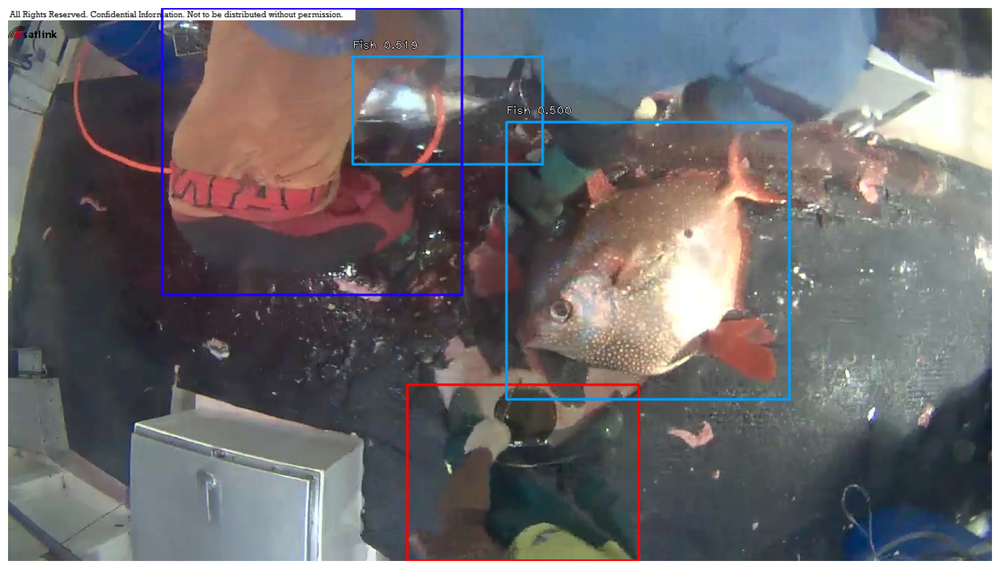

In [ ]:
fishNofish_test = pd.read_csv("fishNofish_test_with_header.csv")
fishNofish_val = pd.read_csv("fishNofish_val_with_header.csv")
labels_to_names = pd.read_csv("fishNofish_class_mapping.csv", header=None).T.loc[0].to_dict()
img_path = fishNofish_test.iloc[0].img_id
image                 = read_image_bgr(img_path)
image                 = preprocess_image(image)
image, scale          = resize_image(image)
model                 = model_fishNofish
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
show_detected_objects(fishNofish_test.iloc[0]) #0,22,23


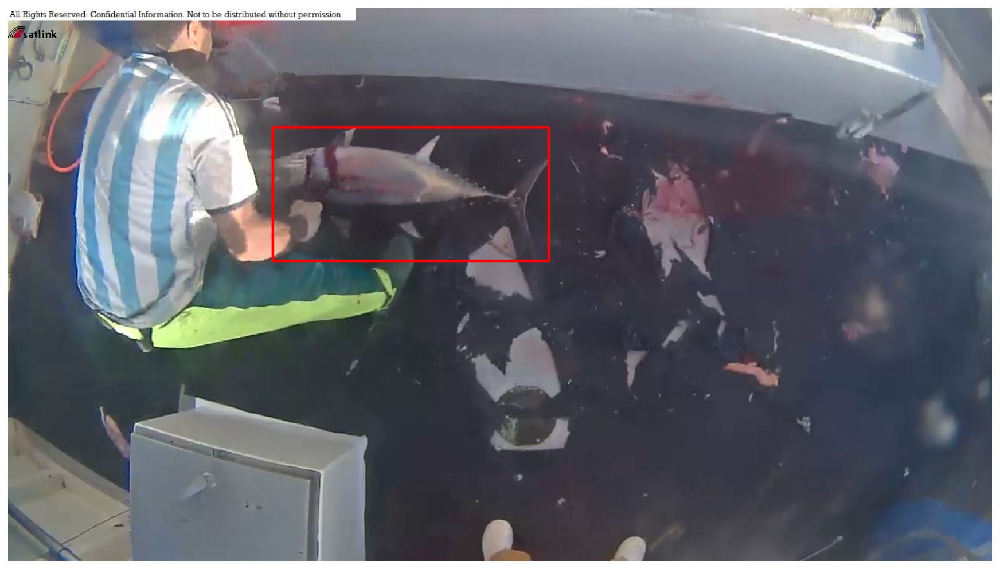

The object is Fish wtih score 0.684192


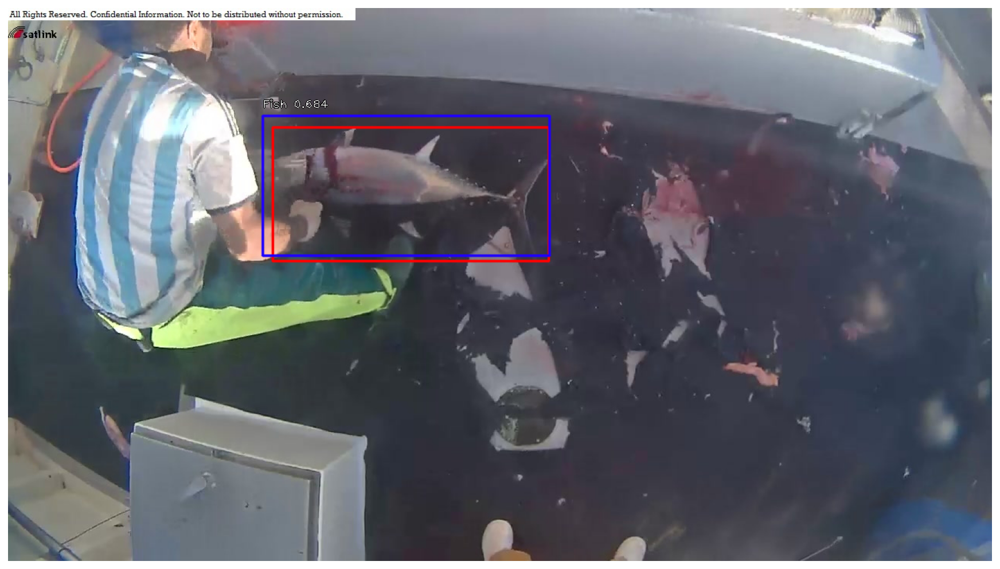

In [ ]:
labels_to_names  = pd.read_csv("fishWithNeg_class_mapping.csv", header=None).T.loc[0].to_dict()
fishWithNeg_test = pd.read_csv("fishWithNeg_test_with_header.csv")
fishWithNeg_val  = pd.read_csv("fishWithNeg_val_with_header.csv")
show_image_objects(fishWithNeg_test.iloc[0])
img_path = fishWithNeg_test.iloc[0].img_id
image                 = read_image_bgr(img_path)
image                 = preprocess_image(image)
image, scale          = resize_image(image)
model                 = model_fishWithNeg
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
show_detected_objects(fishWithNeg_test.iloc[0]) #0 => fish , 1=> no fish, 22

dataset from Kaggle 2017

In [ ]:
kaggle_test_path      = "../Kaggle 2017 Fisheries/sample_submission_stg1.csv/sample_submission_stg1.csv"
kaggle_test     = pd.read_csv(kaggle_test_path)
kaggle_test.head(5)

,image,ALB,BET,DOL,LAG,NoF,OTHER,SHARK,YFT
0,img_00005.jpg,0.455003,0.052938,0.030969,0.017734,0.123081,0.079142,0.046585,0.194283
1,img_00007.jpg,0.455003,0.052938,0.030969,0.017734,0.123081,0.079142,0.046585,0.194283
2,img_00009.jpg,0.455003,0.052938,0.030969,0.017734,0.123081,0.079142,0.046585,0.194283
3,img_00018.jpg,0.455003,0.052938,0.030969,0.017734,0.123081,0.079142,0.046585,0.194283
4,img_00027.jpg,0.455003,0.052938,0.030969,0.017734,0.123081,0.079142,0.046585,0.194283


In [ ]:
a = kaggle_test[["image"]].values.tolist()
for i in range(0,len(a)) :
  a[i] = "../Kaggle 2017 Fisheries/test_stg1/test_stg1/" + ''.join(a[i])
img_id = pd.DataFrame(a,columns=["img_id"])
path = img_id.iloc[10].img_id

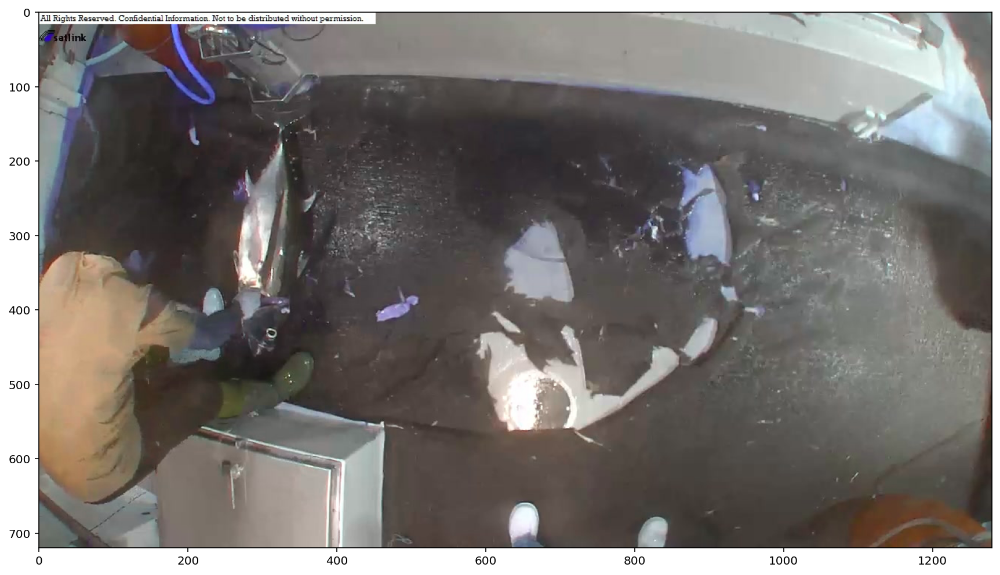

In [ ]:
img = read_image_bgr(path)
plt.imshow(img)

The object is Fish wtih score 0.515466


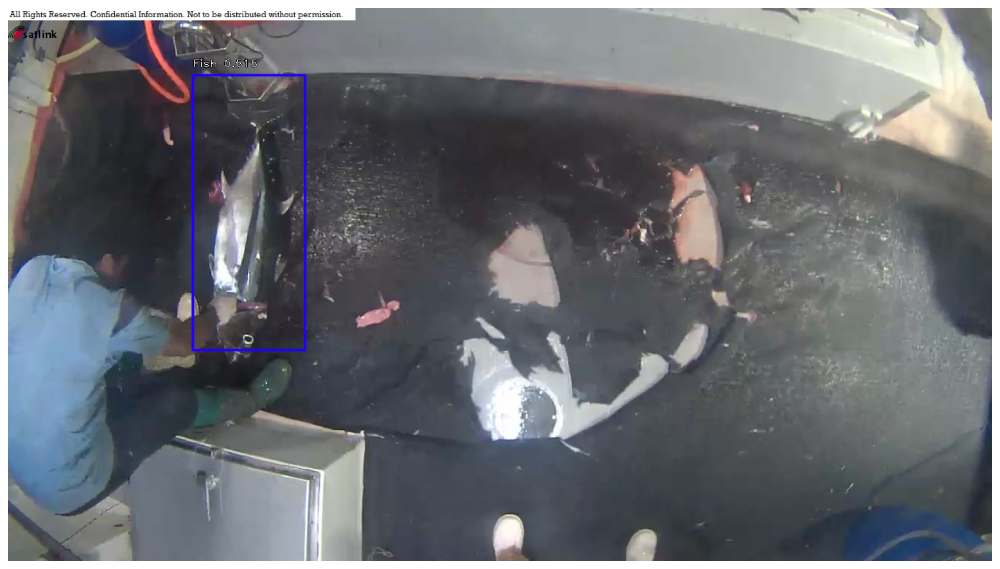

In [ ]:
show_detected_objects_only(path)

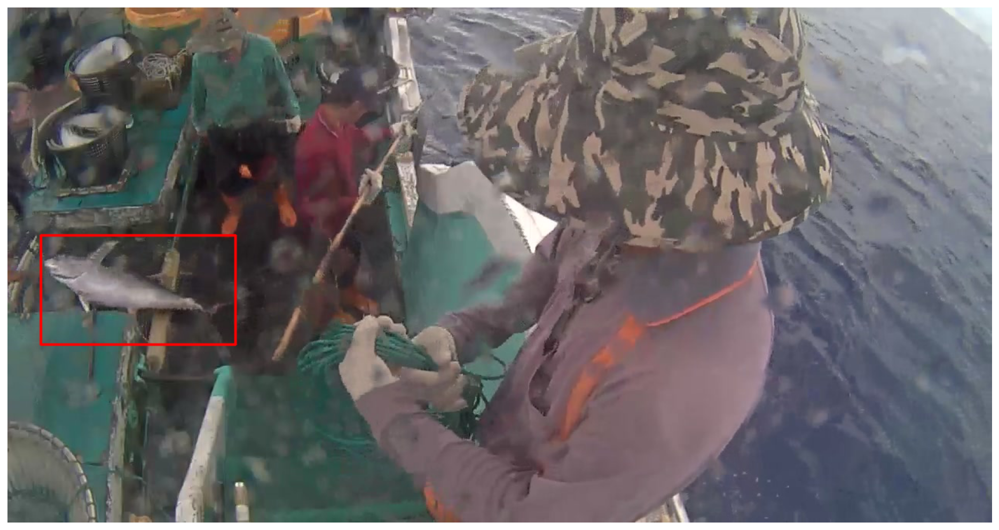

The object is No Fish wtih score 0.653961
The object is Fish wtih score 0.508187


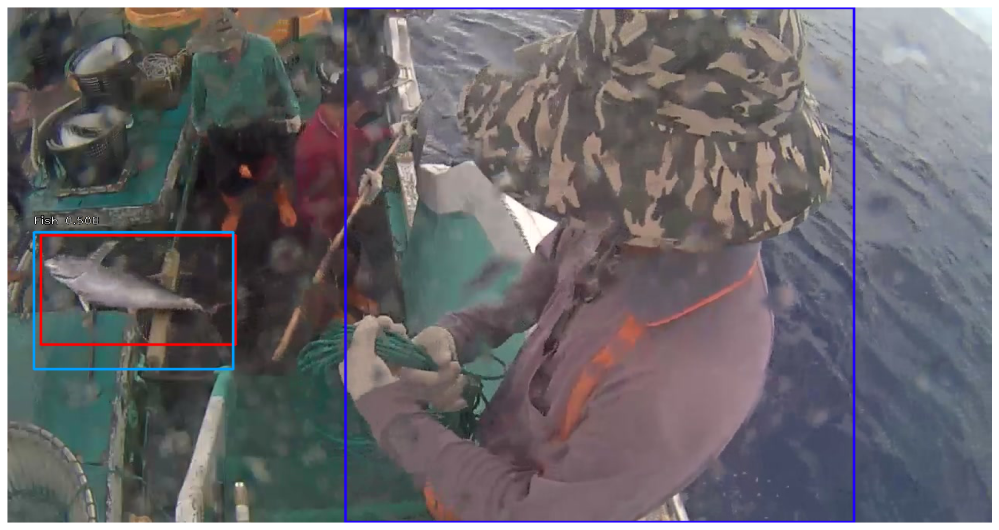

In [ ]:
fishNofish_test = pd.read_csv("fishNofish_test_with_header.csv")
fishNofish_val = pd.read_csv("fishNofish_val_with_header.csv")
labels_to_names = pd.read_csv("fishNofish_class_mapping.csv", header=None).T.loc[0].to_dict()
show_image_objects(fishNofish_test.iloc[24])
img_path = fishNofish_test.iloc[24].img_id
image                 = read_image_bgr(img_path)
image                 = preprocess_image(image)
image, scale          = resize_image(image)
model                 = model_fishNofish
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
show_detected_objects(fishNofish_test.iloc[24]) #0,22,23


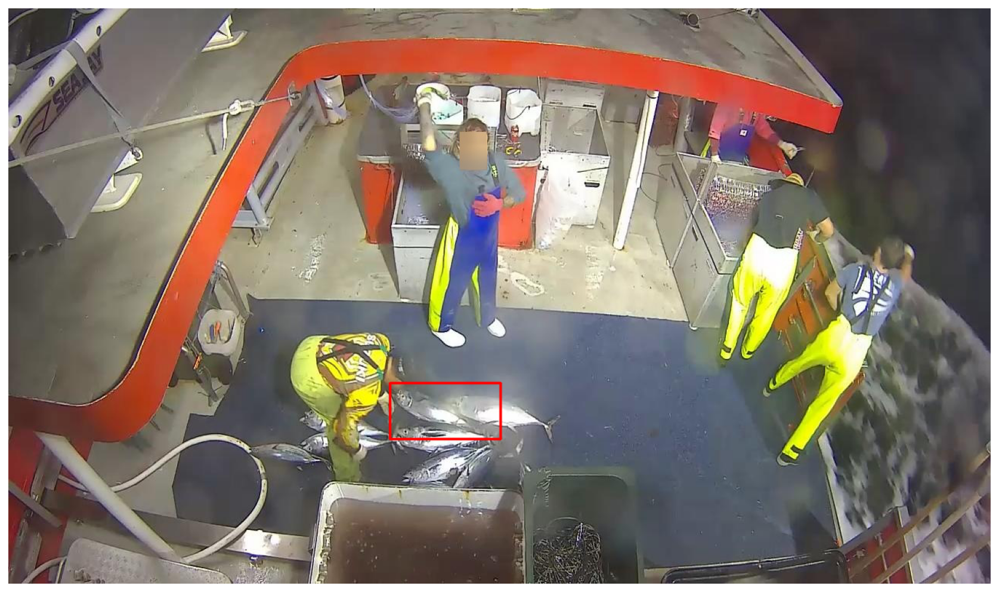

The object is Tuna wtih score 0.699881
The object is Tuna wtih score 0.597785
The object is Tuna wtih score 0.575138
The object is No Fish wtih score 0.569429
The object is No Fish wtih score 0.548640
The object is No Fish wtih score 0.542501
The object is Tuna wtih score 0.521278
The object is No Fish wtih score 0.510857


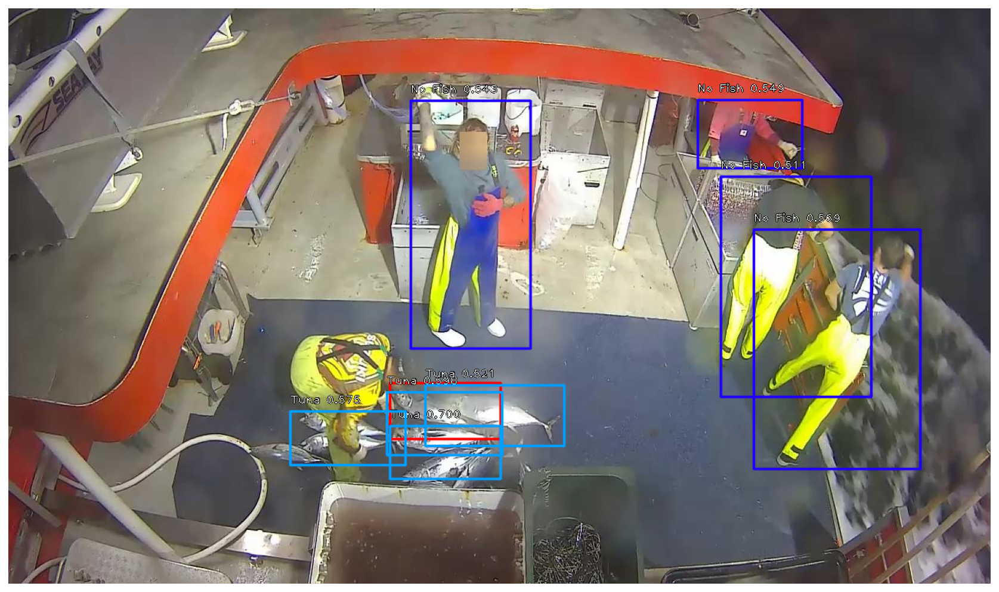

In [ ]:
labels_to_names = pd.read_csv("genericFish_class_mapping.csv", header=None).T.loc[0].to_dict()
genericFish_test = pd.read_csv("genericFish_test_with_header.csv")
genericFish_val = pd.read_csv("genericFish_val_with_header.csv")
show_image_objects(genericFish_test.iloc[6])
img_path = genericFish_test.iloc[6].img_id
image                 = read_image_bgr(img_path)
image                 = preprocess_image(image)
image, scale          = resize_image(image)
model                 = model_genericFish
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
show_detected_objects(genericFish_test.iloc[6]) #0

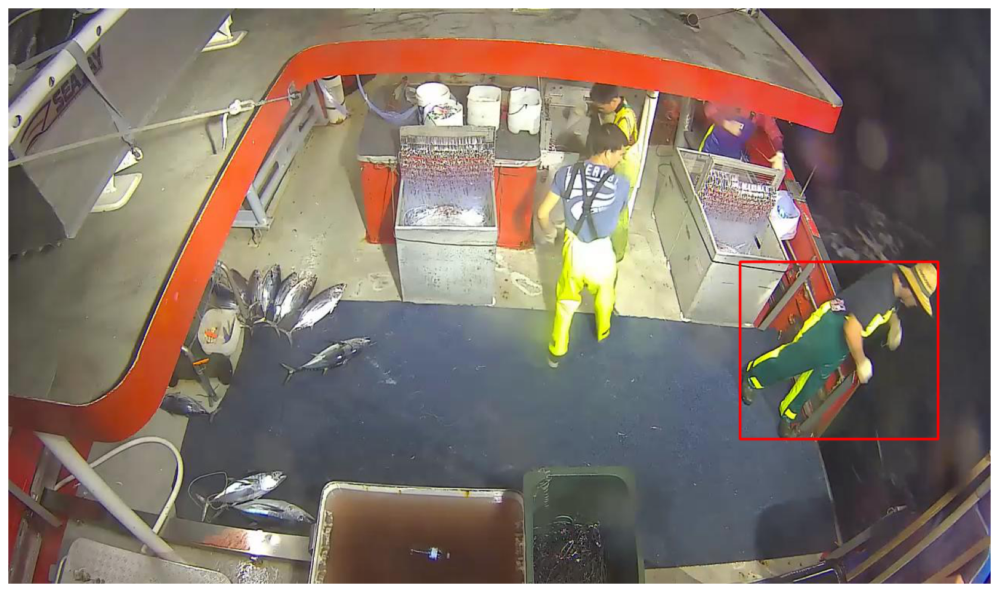

The object is Skipjack tuna wtih score 0.590879
The object is Human wtih score 0.545642
The object is Human wtih score 0.527642
The object is Skipjack tuna wtih score 0.514241
The object is Human wtih score 0.513935


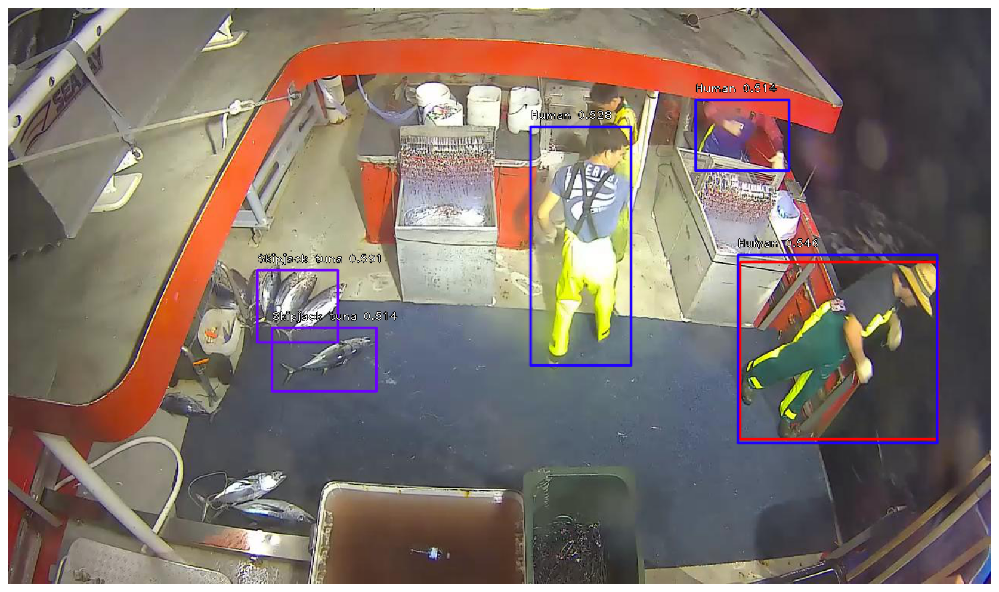

In [ ]:
labels_to_names = pd.read_csv("AllLabel_mapping.csv", header=None).T.loc[0].to_dict()
AllLabel_test   = pd.read_csv("AllLabel_test_with_header.csv")
AllLabel_val    = pd.read_csv("AllLabel_val_with_header.csv")
show_image_objects(AllLabel_test.iloc[33])
img_path = AllLabel_test.iloc[33].img_id
image                 = read_image_bgr(img_path)
image                 = preprocess_image(image)
image, scale          = resize_image(image)
model                 = model_AllLabel
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
show_detected_objects(AllLabel_test.iloc[33]) #22, 122,


#6. Testing and Validating the Model

Import all of required packages

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters
from sklearn.model_selection import train_test_split
import urllib
import os
import csv
import cv2
import time
import skimage.io
from sklearn import datasets
from sklearn import preprocessing
from PIL import Image
import math
import sys
import random

from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

ModuleNotFoundError: ignored

In [ ]:
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [ ]:
#model_path = os.path.join('snapshots',sorted(os.listdir('snapshots'), reverse=True)[0])  #pre-trained model can be pre saved and re loaded.
model_fishWithNeg       = ("./snapshots/fishWithNeg.h5")
model_path_AllLabel     = ("./snapshots/AllLabel.h5")
model_path_fishNofish   = ("./snapshots/fishNofish.h5")
model_path_genericFish  = ("./snapshots/genericFish.h5")

In [ ]:
#pre_trained_model= models.load_model(model_path_pretrained, backbone_name='resnet50')
model_fishWithNeg = models.load_model(model_fishWithNeg, backbone_name='resnet50')
model_AllLabel = models.load_model(model_path_AllLabel, backbone_name='resnet50')
model_fishNofish = models.load_model(model_path_fishNofish, backbone_name='resnet50')
model_genericFish = models.load_model(model_path_genericFish, backbone_name='resnet50')

In [ ]:
#model= models.convert_model(model)
#model_1= models.convert_model(pre_trained_model)
model_fishWithNeg  = models.convert_model(model_fishWithNeg)
model_fishNofish  = models.convert_model(model_fishNofish)
model_genericFish = models.convert_model(model_genericFish)
model_AllLabel    = models.convert_model(model_AllLabel)

In [ ]:
!chmod 755 -R keras_retinanet # provide access to google drive

In [ ]:
#pre_trained_model= models.load_model(model_path_pretrained, backbone_name='resnet50')
model_AllLabel = models.load_model(model_path_AllLabel, backbone_name='resnet50')
model_fishNofish = models.load_model(model_path_fishNofish, backbone_name='resnet50')
model_genericFish = models.load_model(model_path_genericFish, backbone_name='resnet50')

Convert to inference model

In [ ]:
#model= models.convert_model(model)
#model_1= models.convert_model(pre_trained_model)
model_fishNofish  = models.convert_model(model_fishNofish)
model_genericFish = models.convert_model(model_genericFish)
model_AllLabel    = models.convert_model(model_AllLabel)

In [ ]:
 fields = ['NAME_ID', 'XMIN', 'YMIN', 'XMAX', 'YMAX']

model= models.convert_model(model)
model_1= models.convert_model(pre_trained_model)
model_fishNofish  = models.convert_model(model_fishNofish)
model_genericFish = models.convert_model(model_genericFish)
model_AllLabel    = models.convert_model(model_AllLabel)
model_path = os.path.join('snapshots',sorted(os.listdir('snapshots'), reverse=True)[0])  #pre-trained model can be pre saved and re loaded.
model_path_AllLabel  = ("./snapshots/AllLabel.h5")
model_path_fishNofish  = ("./snapshots/fishNofish.h5")
model_path_genericFish  = ("./snapshots/genericFish.h5")
model_path_genericFish  = ("./snapshots/fishWithNeg.h5")



Actual evaluation fuction. Evauates the models to parameters set in config files.

In [ ]:
keras-retinanet/keras_retinanet/bin/evaluate.py --gpu 4 --score-threshold 0.5 --convert-model --image-min-side 600 --save-path "" --image-max-side 3000 csv "AllLabel_test.csv" "AllLabel_mapping.csv" "./snapshots/AllLabel.h5" > "/content/drive/MyDrive/Colab Notebooks/FishNet/results/test_model1_01.txt"
keras-retinanet/keras_retinanet/bin/evaluate.py --gpu 4 --score-threshold 0.5 --convert-model --image-min-side 600 --save-path "" --image-max-side 3000 csv "fishNoFish_Test.csv" "fishNofish_class_mapping.csv" "./snapshots/fishNofish.h5" > "/content/drive/MyDrive/Colab Notebooks/FishNet/results/test_model2_01.txt"
keras-retinanet/keras_retinanet/bin/evaluate.py --gpu 4 --score-threshold 0.5 --convert-model --image-min-side 600 --save-path "" --image-max-side 3000 csv "genericFish__Test.csv" "genericFish_class_mapping.csv" "./snapshots/genericFish.h5" > "/content/drive/MyDrive/Colab Notebooks/FishNet/results/test_model3_01.txt"
